In [1]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [39]:
dataroot = "../Data/CelebA"

# Number of workers for dataloader
workers = 1

# Batch size during training
batch_size = 74

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of conditional vector (appended to the latent vector)
ndomcol= 3
ntags = 38
ninfo = ndomcol + ntags
#ntitlevect = 768
#ntitlevectlower = 50
ncond = 20

# Size of z latent vector (i.e. size of generator input)
nz = 50

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 1000

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

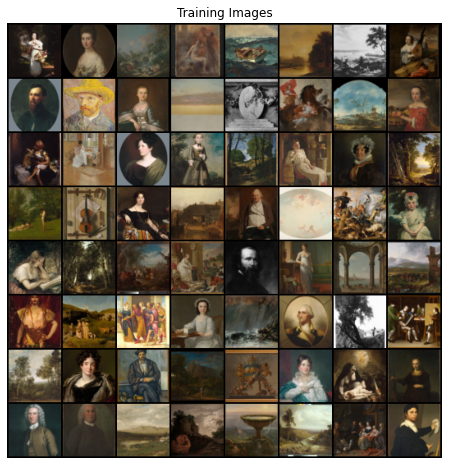

In [40]:
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [4]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [5]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.cond = nn.Sequential(
            nn.Linear(ninfo, 10),
            nn.LeakyReLU(0.2),
            nn.Linear(10, ncond),
            nn.LeakyReLU(0.2)
            #nn.Tanh()
        )
        self.main = nn.Sequential(
            # input is Z, going into a convolution (+ ncond)
            nn.ConvTranspose2d( nz + ncond, ngf * 16, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 16),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 16, ngf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 4, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )
        
        
    def forward(self, input, info):
        #info = info.reshape((info.shape[0], info.shape[1], 1,1))
        cond = self.cond(info)
        cond = cond.reshape((cond.shape[0], cond.shape[1], 1,1))
        h = torch.cat([input, cond], 1)
        return self.main(h)

In [6]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (cond): Sequential(
    (0): Linear(in_features=41, out_features=10, bias=True)
    (1): LeakyReLU(negative_slope=0.2)
    (2): Linear(in_features=10, out_features=20, bias=True)
    (3): LeakyReLU(negative_slope=0.2)
  )
  (main): Sequential(
    (0): ConvTranspose2d(30, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(256, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): Ba

In [7]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False)
            #nn.Sigmoid()
        )
        self.cond = nn.Sequential(
            nn.Linear(ninfo, 10),
            nn.LeakyReLU(0.2),
            nn.Linear(10, 1),
            #nn.LeakyReLU(0.2)
        )
        
        self.out = nn.Sequential(
            nn.Linear(2, 1),
            nn.Sigmoid()
        )
        

    def forward(self, input, info):
        main = self.main(input)
        cond = self.cond(info)
        main = main.reshape(cond.shape)
        h = torch.cat([main, cond], 1)
        return self.out(h)

In [8]:
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
  )
  (cond): Sequential(
    (0): Linear(in_features=41

In [9]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Load in conditional informton 
cols = np.loadtxt(os.path.join(dataroot, "DomCols.txt"))
cols = cols.reshape(cols.shape[0]//batch_size, batch_size, ndomcol, 1, 1)

tags = np.loadtxt(os.path.join(dataroot, "TagVects.txt"))
tags = tags.reshape(tags.shape[0]//batch_size, batch_size, ntags, 1, 1)

infos = torch.cat([torch.Tensor(cols), torch.Tensor(tags)], 2)

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(batch_size, nz, 1, 1, device=device)

fixed_cond = np.zeros((batch_size, ninfo, 1, 1))
for i in range(batch_size):
    batch_id = random.randint(0, 15)
    img_id = random.randint(0, 73)
    rand_col = cols[batch_id, img_id, :, :]
    rand_tag = tags[batch_id, img_id, :, :]
    fixed_cond[i] = np.concatenate([rand_col, rand_tag])
    
fixed_cond = torch.Tensor(fixed_cond).to(device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Equal probs for conditional info for generating fake imgs:
probs = torch.ones(infos.shape[0])

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [38]:
# Training Loop

# Lists to keep track of progress
# img_list = []
# G_losses = []
# D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        cond = torch.Tensor(infos[i]).to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu, cond.reshape((batch_size, ninfo))).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate batch of random conditional vectors
        idx = probs.multinomial(1)
        rand_cond = infos[idx]
        rand_cond = rand_cond.reshape(rand_cond.shape[1:]).to(device)
        
        # Generate fake image batch with G
        fake = netG(noise, rand_cond.reshape((batch_size, ninfo)))
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach(), rand_cond.reshape((batch_size, ninfo))).view(-1)
        # Calculate D's loss on the all-fake batch
        
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake, fixed_cond.reshape((batch_size, ninfo))).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 100 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise, fixed_cond.reshape((batch_size, ninfo))).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/1000][0/24]	Loss_D: 1.1100	Loss_G: 1.7708	D(x): 0.5430	D(G(z)): 0.3191 / 0.2041
[1/1000][0/24]	Loss_D: 0.8602	Loss_G: 1.6354	D(x): 0.6037	D(G(z)): 0.2195 / 0.2112
[2/1000][0/24]	Loss_D: 1.0646	Loss_G: 2.2298	D(x): 0.6506	D(G(z)): 0.4287 / 0.1257
[3/1000][0/24]	Loss_D: 0.7165	Loss_G: 2.8044	D(x): 0.7508	D(G(z)): 0.3233 / 0.0779
[4/1000][0/24]	Loss_D: 1.0693	Loss_G: 3.4809	D(x): 0.6798	D(G(z)): 0.4306 / 0.0450
[5/1000][0/24]	Loss_D: 0.9955	Loss_G: 2.4331	D(x): 0.7488	D(G(z)): 0.4688 / 0.1007
[6/1000][0/24]	Loss_D: 0.8447	Loss_G: 2.5200	D(x): 0.5331	D(G(z)): 0.1131 / 0.1014
[7/1000][0/24]	Loss_D: 1.2973	Loss_G: 1.4885	D(x): 0.3910	D(G(z)): 0.1730 / 0.2603
[8/1000][0/24]	Loss_D: 1.0578	Loss_G: 2.7660	D(x): 0.6922	D(G(z)): 0.4441 / 0.0815
[9/1000][0/24]	Loss_D: 1.4387	Loss_G: 4.1279	D(x): 0.8875	D(G(z)): 0.6837 / 0.0261
[10/1000][0/24]	Loss_D: 1.0761	Loss_G: 2.6473	D(x): 0.5428	D(G(z)): 0.2728 / 0.1041
[11/1000][0/24]	Loss_D: 1.0158	Loss_G: 1.9669	D(x): 0.5284	D

KeyboardInterrupt: 

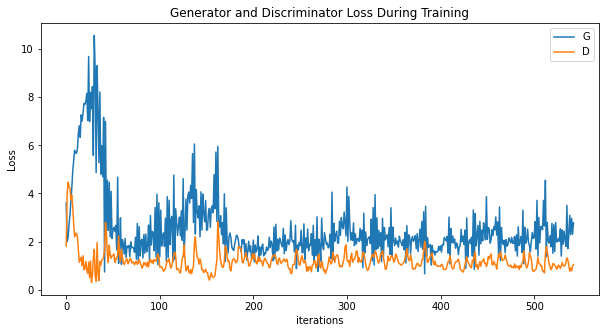

In [11]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

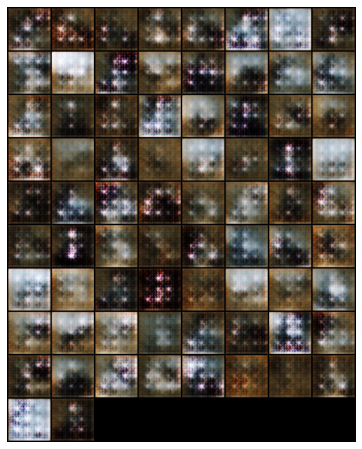

In [12]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

#Writer = animation.writers['ffmpeg']
#writer = Writer(fps=10, metadata=dict(artist='Me'), bitrate=1800)
#ani.save("paint_300.mp4", writer)
HTML(ani.to_jshtml())

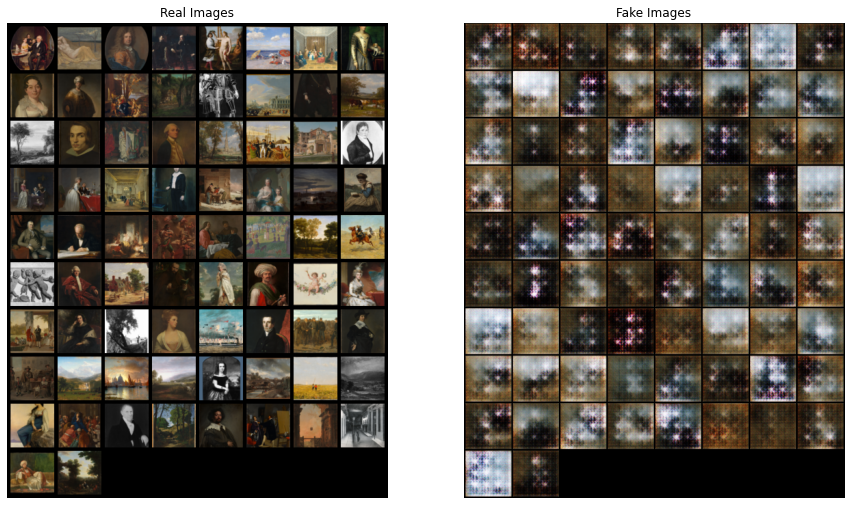

In [13]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:batch_size], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
#plt.savefig("Comparison_2.jpg")
plt.show()

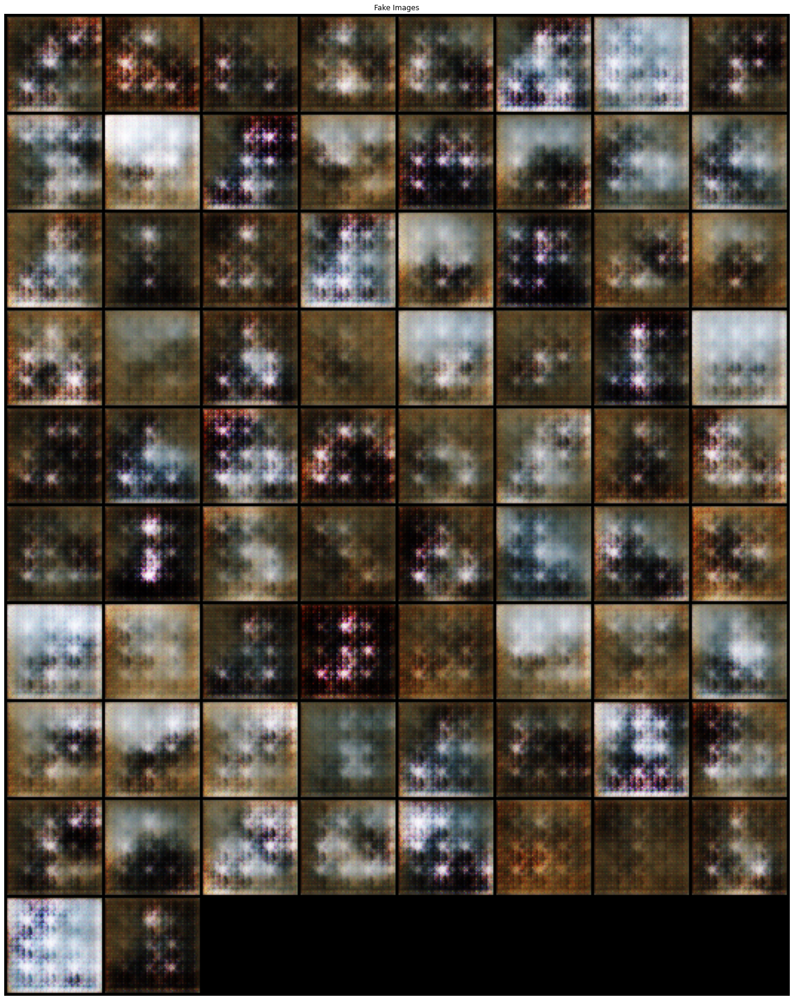

In [14]:
plt.figure(figsize=(30,30))
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
#plt.savefig("BetterConditional_300_epochs_10thlastframe.png")
plt.show()

In [ ]:
# Plot the real images
plt.figure(figsize=(30,30))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))
#plt.savefig("RealPort1.png")


In [ ]:
# torch.cat([fixed_noise, fixed_cond], 1).shape

In [ ]:
# cols = np.loadtxt(os.path.join(dataroot, "DomCols.txt"))
# cols = cols.reshape(cols.shape[0]//batch_size, batch_size, ninfo, 1, 1)

In [16]:
test_noise = fixed_noise

#torch.randn(batch_size, nz, 1, 1, device=device)

In [36]:
#g =  torch.randn(74, 3, 1, 1, device=device)
g = np.ones((74, 3, 1, 1))
g[:,0,:,:] = 0
g[:,2,:,:] = 0
test_cols_g = torch.Tensor(g).to(device)

test_cols = torch.Tensor(cols[0]).to(device)
test_tags = torch.Tensor(tags[5]).to(device)

w_port = test_tags[0, :, :]
for i in range(38):
    w_port[i, 0, 0] = random.choice([0.,1.])

for i in range(batch_size):
    test_tags[i, :, :, :] = w_port

test_infos = torch.cat([test_cols_g, test_tags], 1)
fake_test = netG(test_noise, test_infos.reshape((batch_size, ninfo))).detach().cpu()

img_test_1 = vutils.make_grid(fake_test, padding=2, normalize=True)

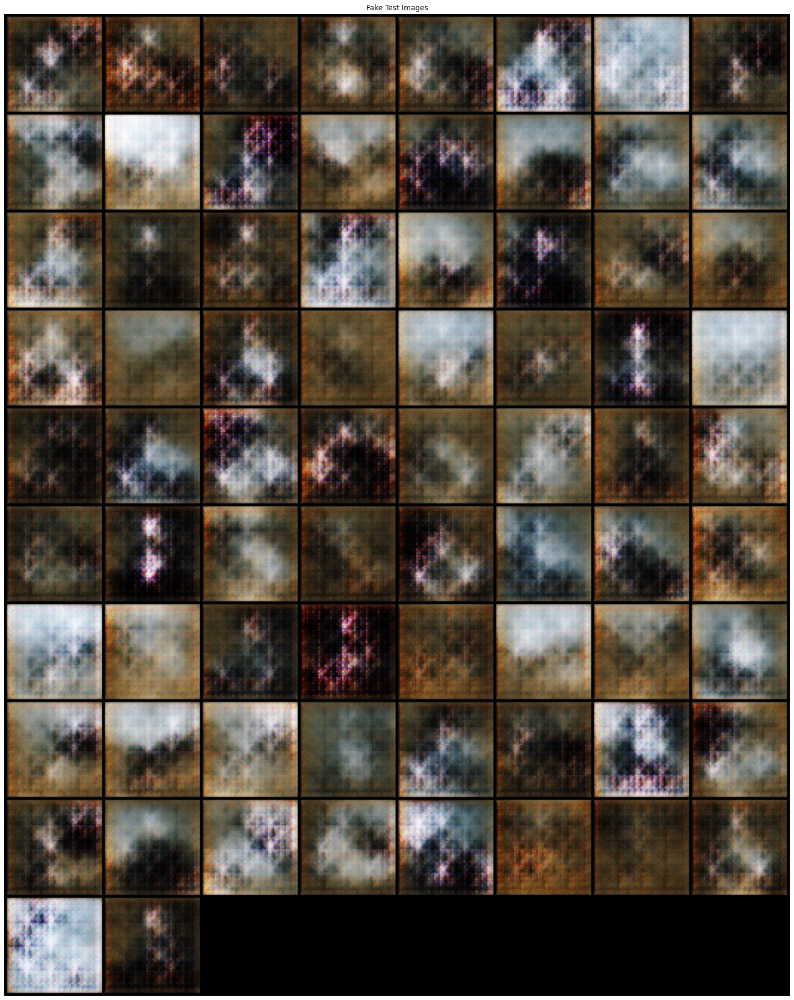

In [35]:
plt.figure(figsize=(30,30))
plt.axis("off")
plt.title("Fake Test Images")
plt.imshow(np.transpose(img_test,(1,2,0)))
plt.show()

1